In [1]:
from client_side.client import client
from server_side.workers import phone_support
from server_side.vm import vm_deliver
from server_side.server import server
from settings.statistic import statistic_collector
from simpy import Environment
import matplotlib.pyplot as plt
import pandas
import numpy as np

time = 1000
skip = 0
# env = Environment()
# client(env, phone_support(env), vm_deliver(env, server(env, "server")))
# env.run(until=time)
# statistic_collector.save()

In [2]:
for key in statistic_collector.load:
    print(f"{key}: {statistic_collector.load[key]}")

clien_count: 111738
client_vms_1: [0, 1, 1, 1, 2, 3, 3, 4, 5, 5, 6, 6, 7, 8, 9, 9, 0, 1, 2, 3, 4, 5, 5, 6, 0, 1, 1, 2, 3, 4, 5, 6, 6, 7, 8, 8, 9, 9, 9, 10, 10, 11, 12, 13, 13, 13, 13, 14, 15, 16, 17, 17, 17, 17, 17, 18, 18, 18, 18, 18, 18, 18, 19, 19, 20, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 22, 23, 23, 23, 23, 23, 23, 23, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 27, 27, 27, 27, 28, 29, 29, 30, 30, 30, 30, 31, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 

In [5]:
df = pandas.DataFrame()
import warnings
warnings.filterwarnings("ignore")
for key in statistic_collector.load:
    if key[:10] == "client_vms":
        if len(statistic_collector.load[key]) == 1 and statistic_collector.load[key][0] == 0:
            continue
        # plt.plot(statistic_collector.load[key])
        x = [np.NaN] * (time // 2 - len(statistic_collector.load[key])) + statistic_collector.load[key]
        try:
            df[key] = np.array(x)
        except:
            print(key)
        
df['mean'] = df.mean(axis=1)        
df["sum"] = df.sum(axis=1)
df1 = df.iloc[skip:]
df.head()


client_vms_14396
client_vms_2018


,client_vms_1,client_vms_12,client_vms_13,client_vms_134,client_vms_15,client_vms_16,client_vms_17,client_vms_138,client_vms_169,client_vms_170,...,client_vms_1428376768,client_vms_17839489,client_vms_17157740,client_vms_1823001,client_vms_124412,client_vms_110813,client_vms_252914,client_vms_110335,mean,sum
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
4,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0


In [6]:
df.to_csv("stat.csv")

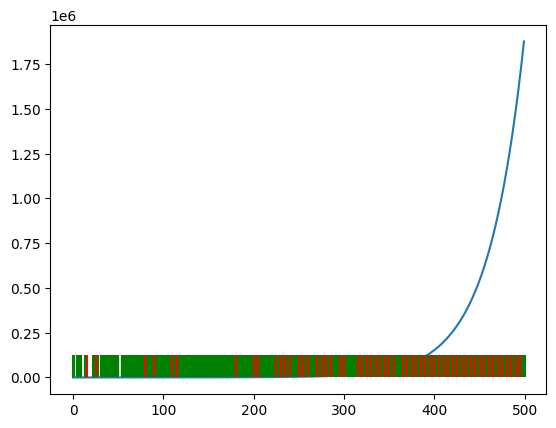

In [7]:
plt.plot(df['sum'])
plt.vlines([x // 2 for x in statistic_collector.load["break_time_vm"]], 0, df['sum'].max() // 15, 'g')
plt.vlines([x // 2 for x in statistic_collector.load["break_time_hadoop_claster"]], 0, df['sum'].max() // 15, 'r')
plt.vlines([x // 2 for x in statistic_collector.load["break_time_proxmox_claster"]], 0, df['sum'].max() // 15, 'r')

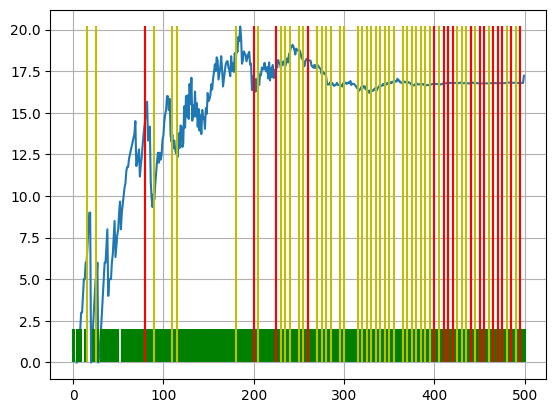

In [8]:
plt.plot(df['mean'])
plt.vlines([x // 2 - skip for x in statistic_collector.load["break_time_vm"]], 0, df['mean'].max() / 10, 'g')
plt.vlines([x // 2 - skip for x in statistic_collector.load["break_time_hadoop_claster"]], 0, df['mean'].max(), 'y')
plt.vlines([x // 2 - skip for x in statistic_collector.load["break_time_proxmox_claster"]], 0, df['mean'].max(), 'r')
plt.grid()

In [9]:
df['mean'].mean()

15.185835181950969

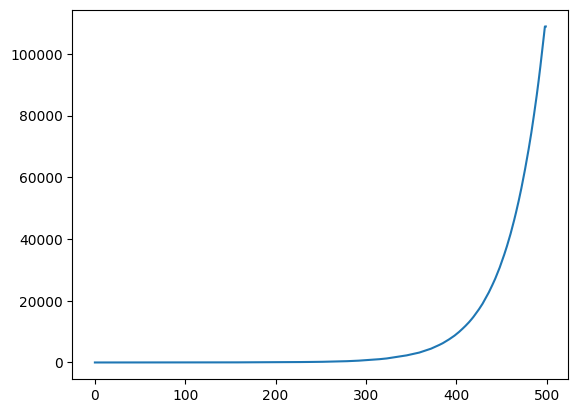

In [10]:
df['non_null_count'] = df.count(axis=1)
plt.plot(df['non_null_count'])